# MEMORIA

Mi EDA esta centrado en el ajedrez.   

Pretendo realizar un acercamiento para mis compañeros al juego, explicaciones de FIDE como organizacion y sus cometidos, como la supervision de puntuación ELO, creacion y entrega de titulos, organizacion de torneos, etc.  
  
Tambien realizaremos un breve repaso sobre diferentes periodos historicos y jegadores excepcionales de la epoca. 

Acompañaremos esta informacion con estadisticas y analisis para obtener conclusiones y perspectivas de este deporte y con suerte suscitar interes y un acercamiento entre los oyentes.

Comenzaremos importando las librerias y modulos con que trabajaremos en adelante:

In [7]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

Creamos dataframes con las bases de datos con que contamos y las limpiamos.

Disponemos de diferentes bases de datos las cuales definiremos brevemente en las siguientes celdas.

## chess_titled_players.csv

In [8]:
# en esta base de datos contamos con 20000 jugadores aprox a lo largo de la historia con datos sobre ELO, nacionalidad, elo por tipologia de partida, sexo y mas

df_titled = pd.read_csv('./data/data_20000p_2021_historico/chess_titled_players.csv')

In [9]:
# segregamos una base de datos que unicamente contiene los años de obtencion de los titulos

df_titles_year = df_titled[['name', 'title', 'woman_title', 'Woman Candidate Master (WCM)', 'Candidate Master (CM)', 'Woman FIDE Master (WFM)', 'FIDE Master (FM)',
                           'Woman International Master (WIM)', 'International Master (IM)', 'Woman Grandmaster (WGM)', 'Grandmaster (GM)']]
#df_titles_year.to_csv('df_year_titled.csv')

In [10]:
# limpio esas columnas del df original para no sobrecargarlo, trabajare con dos df.

df_titled.drop(columns= ['Woman Candidate Master (WCM)', 'Candidate Master (CM)', 'Woman FIDE Master (WFM)', 'FIDE Master (FM)', 'Woman International Master (WIM)',
                         'International Master (IM)', 'Woman Grandmaster (WGM)', 'Grandmaster (GM)', 'Unnamed: 0', 'woman_title'], inplace= True)

# limpio nulos de la columna birth_year
# no relleno datos de las columnas de elo en tipologia de partida porque quizas esos jugadores no jugaban en ese tipo de partidas y no quiero falsear los datos

df_titled['birth_year'].fillna(df_titled['birth_year'].median(), inplace= True)

#df_titled.to_csv('df_titled_limpio.csv')

C:\Users\franc\AppData\Local\Temp\ipykernel_24560\878489171.py:9: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_titled['birth_year'].fillna(df_titled['birth_year'].median(), inplace= True)


## fide_active_players_2023_limpio.csv

In [11]:
# este dataset contien datos de 5000 jugadores FIDE aprox registrados y esta bastante limpio, apennas tiene algunos ELOS de tipologias de partidas nulos que no pretendo falsear

## game_data.csv

In [12]:
# este dataframe contiene datos de partidas de 12 grandes maestros del ajedrez a lo largo de la historia. 
# cuenta con 21500 entradas aprox

df_gm = pd.read_csv('./data/GM_12/game_data.csv')

# elimino columnas inncesarias

df_gm.drop(columns= ['lines', 'file_name'], inplace= True)

# formateamos la columna de birth_year a datetime. no todas las entradas comparten el mismo formato, en algunas falta el mes, en otras el dia, etc
# para solventar esto iteramos sobre las entradas y formateamos a datetime acorde al tipo de formato que tiene la casilla en cuestion

for i in range(len(df_gm['date'])):
    try:
        df_gm['date'][i] = pd.to_datetime(df_gm['date'][i])
    except ValueError:
        try:
            df_gm['date'][i] = pd.to_datetime(df_gm['date'][i], format= '%Y.??.??')
        except ValueError:
            df_gm['date'][i] = pd.to_datetime(df_gm['date'][i], format= '%Y.%m.??')

df_gm['date'] = pd.to_datetime(df_gm['date'])

# df_gm.to_csv('GM_21000_limpio.csv')

C:\Users\franc\AppData\Local\Temp\ipykernel_24560\3756709214.py:18: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_gm['date'][i] = pd.to_datetime(df_gm['date'][i], format= '%Y.??.??')
C:\Users\franc\AppData\Local\Temp\ipykernel_24560\37567

## data de fischer

In [13]:
# en esta data disponemos de 850 partidas prox del jugador bobby fischer

df_fisher = pd.read_csv('./data/fisher/fischer_game_info.csv')

# eliminamos columnas innecesarias o que estan casi nulas completamente

df_fisher.drop(columns= ['game_id', 'game_order', 'round', 'winner_elo', 'loser_elo', 'winner_loser_elo_diff', 'eco', 'date_created', 'file_name'], inplace= True)

# convierto a formato datetima la columna de fecha, ajusto el formato para mostrar el año, puesto que todas las fechas estan en formato año.??.??

df_fisher['date_played'] = pd.to_datetime(df_fisher['date_played'], format='%Y.??.??')

# df_fisher.to_csv('df_fisher_limpio.csv')

## data de kasparov

In [14]:
# en este data contamos con 2100 partidas aprox de kasparov

df_kasparov = pd.read_csv('./data/kasparov_76_21/Kasparov_game_info.csv')

# elimino columnas inncesarias

df_kasparov.drop(columns= ['game_id', 'game_order', 'round', 'winner_elo', 'loser_elo', 'winner_loser_elo_diff', 'eco', 'date_created', 'file_name'], inplace= True)

# convierto a datetime la columna de fecha siguiendo un proceso similar al anterior puesto que encontramos diferentes estados en las fechas

for i in range(len(df_kasparov['date_played'])): # hay fechas en distintos formatos, itero sobre la columna utilizando su rango para modificar el valor de cada valor a datetime, si da
                                                 # error salta el try e intenta con otro formato, si falla salta el segundo try e intenta el ultimo y cuanto formato
    try:
        df_kasparov['date_played'][i] = pd.to_datetime(df_kasparov['date_played'][i])
    except ValueError:
        try:
            df_kasparov['date_played'][i] = pd.to_datetime(df_kasparov['date_played'][i], format='%Y.??.??')
        except ValueError:
            df_kasparov['date_played'][i] = pd.to_datetime(df_kasparov['date_played'][i], format='%Y.%m.??')

df_kasparov['date_played'] = pd.to_datetime(df_kasparov['date_played']) # sin esta linea final no aparece como datetime en info

# df_kasparov.to_csv('df_kasparov_limpio.csv')

C:\Users\franc\AppData\Local\Temp\ipykernel_24560\98909404.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_kasparov['date_played'][i] = pd.to_datetime(df_kasparov['date_played'][i])
C:\Users\franc\AppData\Local\Temp\ipykernel_24560\9

## data de carlsen

In [15]:
# en este data disponemos de 4300 partidas aprox de carlsen

# elimino las columnas innecesarias
df_carlsen = pd.read_csv('./data/carlsen/Carlsen_game_info.csv')
df_carlsen.drop(columns= ['white_rating_diff', 'black_rating_diff', 'white_title', 'black_title', 'termination', 'time_control', 'utc_date', 'utc_time', 'variant', 'ply_count'], inplace= True)
df_carlsen.drop(columns= ['game_id' ,'game_order', 'round', 'date_created', 'file_name', 'eco', 'winner_loser_elo_diff'], inplace= True)
df_carlsen.drop(columns= ['loser_elo', 'winner_elo'], inplace= True)

df_carlsen['date_played'] = pd.to_datetime(df_carlsen['date_played'], errors= 'coerce')
# paso a datetime la columna de fechas, el paramentro errors pasa a NaT los que no siguen el formato

df_carlsen.dropna(inplace= True) # son pocas lineas con nulos asi que no me importa prescindir de ellas

# df_carlsen.to_csv('df_carlsen_limpio.csv')

# comenzamos a analizar datos

comenzamos con el data historico con los jugadores y la obtencion de sus titulos

In [16]:
df_players = pd.read_csv('./data/data_20000p_2021_historico/df_titled_limpio.csv')
df_players['birth_year'] = pd.to_datetime(df_players['birth_year'])

In [17]:
# quiero ver cuantos titulos hay en la actualidad, para ello utilizamos la columna active, una columna binaria que determina si un jugador permanece en activo
df_players[df_players['active'] == 1].title.value_counts()

title
FM     4545
IM     2399
GM     1325
CM     1198
WFM     736
WCM     451
WIM     407
WGM     189
Name: count, dtype: int64

<Axes: xlabel='count'>

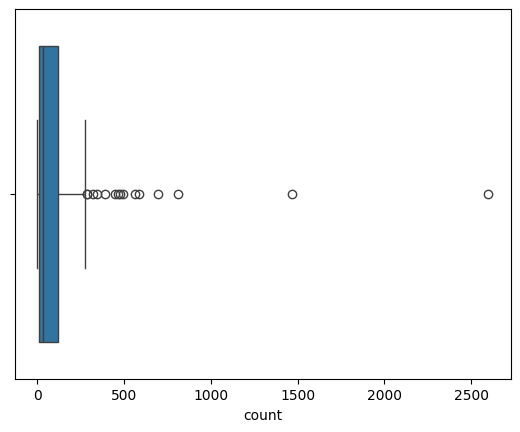

In [18]:
# a ver la dispersion de la cantidad de jugadores por federaciones

sns.boxplot(df_players['country'].value_counts(), orient= 'h')

In [19]:
# vamos a segmentar las federaciones que cuentan con mas de 500 jugadores titulados para observar su comportamiento

cc = df_players['country'].value_counts()
df_country_500p = df_players[df_players['country'].isin(cc[cc > 500].index)]

In [20]:
# a ver las medias de los elos agrupados por federaciones

# medias de elo/ tipo partida
df_medias_elo = df_country_500p.groupby('country', as_index= False)[['classical', 'rapid', 'blitz']].mean()
df_medias_elo['media global'] = df_medias_elo[['classical', 'rapid', 'blitz']].mean(axis= 1) # agrego una nueva columna con la media de las tres tipologias, quiero obtener una grafica senciza de visualizar
df_medias_elo


,country,classical,rapid,blitz,media global
0,ESP,2272.422799,2229.110220,2239.725843,2247.086288
1,GER,2275.809134,2287.046512,2277.386541,2280.080729
2,RUS,2270.991914,2218.436821,2203.687388,2231.038708
3,SRB,2249.102041,2254.728532,2241.860274,2248.563616
4,UKR,2302.153298,2261.704715,2258.928191,2274.262068
5,USA,2245.215174,2297.297436,2203.494810,2248.669140


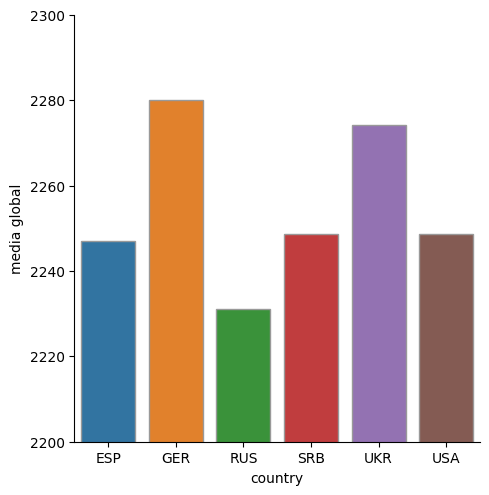

In [21]:
sns.catplot(x="country",
            y = "media global",
            hue = "country",
            kind="bar", # Ojo, cambio el tipo de gráfico (ahora no "cuento" filas)
            edgecolor=".6",
            data=df_medias_elo);
plt.ylim(2200, 2300)
#plt.savefig('elo_global_por_federaciones.png')
plt.show()

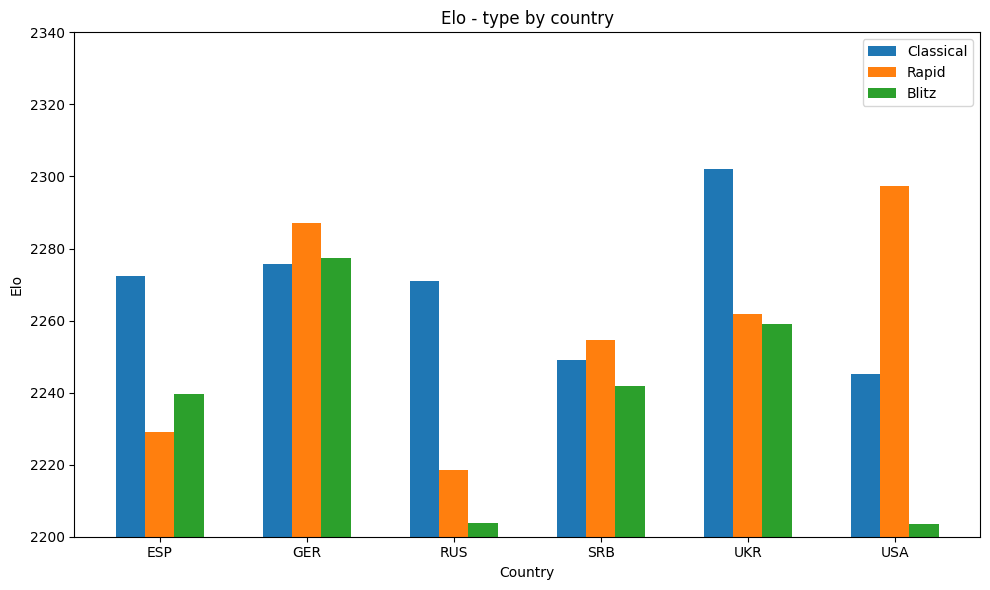

In [22]:
'''
a ver los elos por federaciones en funcion del estilo de juego

classic, rapid y blitz

esta grafica al final la obvie porque me parecio mucha info para la diapositiva y mi intencion es hacer un acercamiento suave al publico
'''

categorias = df_medias_elo['country']
variables_numericas = {
    'Classical': df_medias_elo['classical'],
    'Rapid': df_medias_elo['rapid'],
    'Blitz': df_medias_elo['blitz']
}

# Configuración de la figura y los ejes
fig, ax = plt.subplots(figsize=(10, 6))

# Ancho de las barras
bar_width = 0.2

# Índices para las posiciones de las barras
indice = np.arange(len(categorias))

# Gráfico de barras para cada variable numérica
for i, (variable, valores) in enumerate(variables_numericas.items()):
    ax.bar(indice + i * bar_width, valores, bar_width, label=variable)

# Configuración de ejes y etiquetas
ax.set_xlabel('Country')
ax.set_ylabel('Elo')
ax.set_title('Elo - type by country')
ax.set_xticks(indice + bar_width)
ax.set_xticklabels(categorias)
ax.legend()
plt.ylim(2200, 2340)

# Mostrar la gráfica
plt.tight_layout()
#plt.savefig('elo_tipos_por_paises.png')
plt.show()

In [24]:
# voy a ver los años en que se titularon los jugadores y ver como estan distribuidos  
# aqui volcamos el data que segregamos con las fechas de la obtencion de los titulos

df_titles = pd.read_csv('./data/data_20000p_2021_historico/df_year_titled.csv')
df_titles.drop(columns= ['Unnamed: 0', 'name', 'title', 'woman_title'], inplace= True)

In [25]:
# vamos a ver la info de RUS y USA, tengo curiosidad de los titulos otorgados a estas potencias durante la guerra fria
df_titles_USA = df_titles[df_titles['country'] == 'USA']
df_titles_RUS = df_titles[df_titles['country'] == 'RUS']


In [26]:
# si observamos la data, en las filas aparecen los titulos como columna y el año obtencion de cada uno (si se obtuvo) en la celda. Lo que yo necesito es la cantidad de cada titulo por año

# la idea de esta funcion es obtener un df con la cantidad de titulos se obtivieron en cada año
def titulos_anio(df):
    data = {'q': []}
    for anio in range(1950, 2022):  # el año minimo y maximo, con esto visualizaremos el eje x
        q = (df == anio).sum().sum() # esto va trabajando por columna (sumando la cantidad de Trues por cada columna) y luego suma todas las columnas
        data['q'].append(q)
    return pd.DataFrame(data, index= [i for i in range(1950, 2022)])

In [27]:
# titulos obtenidos por año para usa y rus

df_tiles_anio_usa = titulos_anio(df_titles_USA)
df_tiles_anio_rus = titulos_anio(df_titles_RUS)

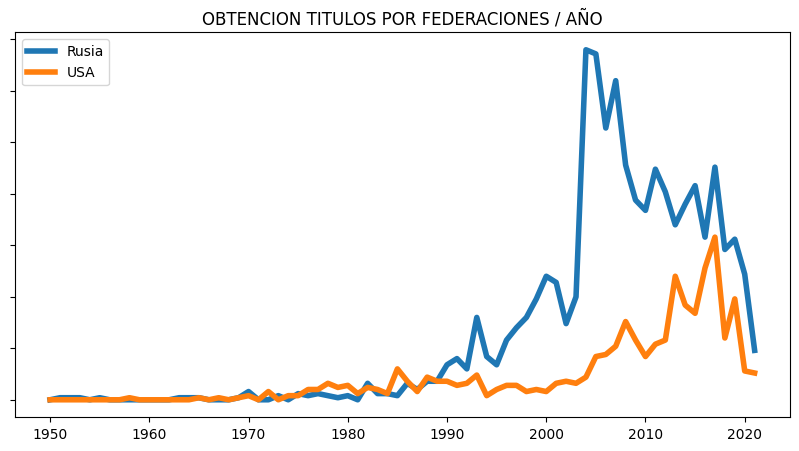

In [28]:
plt.figure(figsize= (10, 5))
plt.plot(df_tiles_anio_rus, label= 'Rusia', linewidth=4)
plt.plot(df_tiles_anio_usa, label= 'USA', linewidth=4)
plt.title('OBTENCION TITULOS POR FEDERACIONES / AÑO')
plt.legend(loc='upper left')
plt.gca().set_yticklabels([]);
#plt.savefig('usa_rus_titulos_por_año.png', transparent= True)
#plt.show()

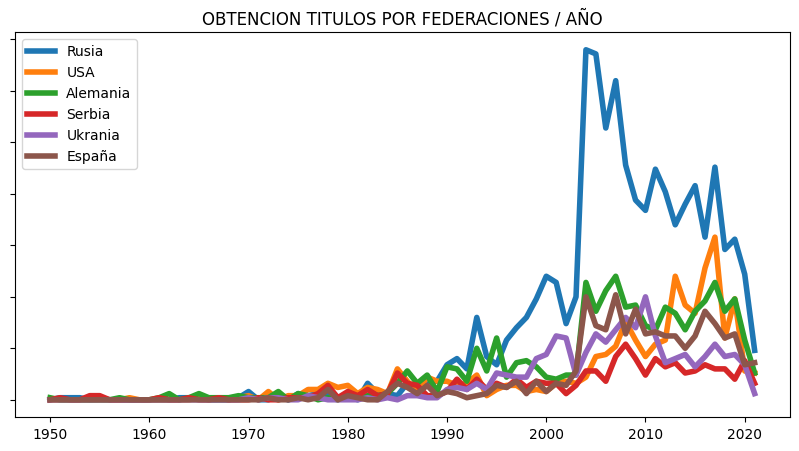

In [29]:
# no encuentro crecimiento exagerado en la epoca de la guerra fria, pero si en torno al año 2000
# quiero comprobar si sucedio en mas federaciones o solo en rusia, voy a comprobarlo en los paises com mas de 500 jugadores que obtuvimos anteriormente

df_titles_ger= df_titles[df_titles['country'] == 'GER']
df_titles_srb = df_titles[df_titles['country'] == 'SRB']
df_titles_ukr = df_titles[df_titles['country'] == 'UKR']
df_titles_esp = df_titles[df_titles['country'] == 'ESP']
df_tiles_anio_ger = titulos_anio(df_titles_ger)
df_tiles_anio_srb = titulos_anio(df_titles_srb)
df_tiles_anio_ukr = titulos_anio(df_titles_ukr)
df_tiles_anio_esp = titulos_anio(df_titles_esp)

plt.figure(figsize= (10, 5))
plt.plot(df_tiles_anio_rus, label= 'Rusia', linewidth=4)
plt.plot(df_tiles_anio_usa, label= 'USA', linewidth=4)
plt.plot(df_tiles_anio_ger, label= 'Alemania', linewidth=4)
plt.plot(df_tiles_anio_srb, label= 'Serbia', linewidth=4)
plt.plot(df_tiles_anio_ukr, label= 'Ukrania', linewidth=4)
plt.plot(df_tiles_anio_esp, label= 'España', linewidth=4)
plt.title('OBTENCION TITULOS POR FEDERACIONES / AÑO')
plt.legend(loc='upper left')
plt.gca().set_yticklabels([]);
#plt.savefig('paises_titulos_por_año.png', transparent= True);


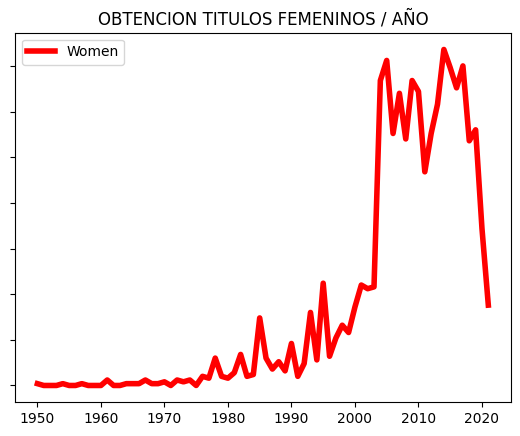

In [30]:
# quiero comprobar si este crecimiento es debido al aumento de jugadores femininos, para ello seleccion los titulos femeninos como referencia

df_titled_woman = df_titles[['Woman FIDE Master (WFM)', 'Woman International Master (WIM)', 'Woman Grandmaster (WGM)']]
# en este df aun estan las filas correspondientes a hombres, podria dropear las columnas NaN completas, pero al pasarle funcion definida antes no contara valores en esas celdas asi que no hay necesidad

df_titled_men = df_titles[['FIDE Master (FM)', 'International Master (IM)', 'Grandmaster (GM)']]
# podria darse el caso de que los titulos masculinos tambien aumentaran en este periodo exageradamente asi que quiero comprobar los titulos masculinos tambien

df_titled_anio_woman= titulos_anio(df_titled_woman) # les pasamos nuestra funcion para ver titulos por año
df_titled_anio_men= titulos_anio(df_titled_men)

plt.plot(df_titled_anio_woman, label= 'Women', color= 'red', linewidth=4)
plt.title('OBTENCION TITULOS FEMENINOS / AÑO')
plt.legend(loc='upper left')
plt.gca().set_yticklabels([]);
#plt.savefig('titulos_año_woman.png', transparent= True)

# pues si hay un aumento femenino exponencial, parece corroborar la hipotesis

# VOY A COMPROBAR TAMBIEN LOS CHICOS

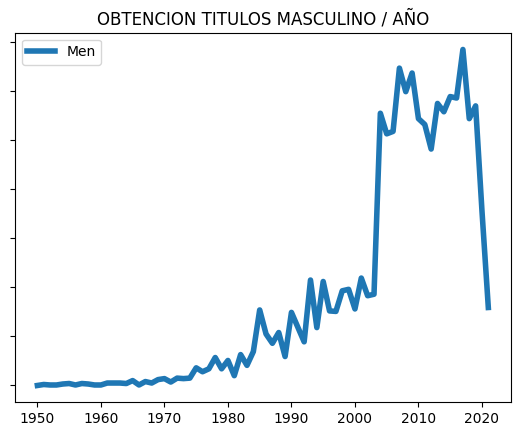

In [31]:
plt.plot(df_titled_anio_men, label= 'Men', linewidth=4)
plt.title('OBTENCION TITULOS MASCULINO / AÑO')
plt.legend(loc='upper left')
plt.gca().set_yticklabels([]);
#plt.savefig('titulos_año_man.png', transparent= True)

# meh, tambien aumenta exponencialmente, no parece que el auge de titulos femeninos fuera la causa del auge general de titulos. rechazo la hipotesis

## pasamos a analizar el data de los 12 grandes maestros a lo largo del tiempo

In [33]:
df_gm = pd.read_csv('./data/GM_12/GM_21000_limpio.csv')

df_gm['date'] = pd.to_datetime(df_gm['date']) # no se carga como datetime

In [34]:
# quiero estudiar por periodos de tiempo, principalmente q de movimientos por partida

año_1880 = pd.to_datetime('1880-01-01') # genero valores datetime para segmentar el df original en df periodicos
año_1920 = pd.to_datetime('1920-01-01')
año_1960 = pd.to_datetime('1960-01-01')
año_2000 = pd.to_datetime('2000-01-01')

df_1880_atras = df_gm[df_gm['date'] < año_1880]
df_1920_atras = df_gm[(df_gm['date'] > año_1880) & (df_gm['date'] < año_1920)]
df_1960_atras = df_gm[(df_gm['date'] > año_1920) & (df_gm['date'] < año_1960)]
df_2000_atras = df_gm[(df_gm['date'] > año_1960) & (df_gm['date'] < año_2000)]
df_2020_atras = df_gm[df_gm['date'] > año_2000]

df_2020_atras['moves'].fillna(df_2020_atras['moves'].mean(), inplace= True)
# en la siguiente celda me daba problemas para generar el boxplot porque habia nulos en la columna de moves. relleno con medias

C:\Users\franc\AppData\Local\Temp\ipykernel_24560\1401603291.py:14: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_2020_atras['moves'].fillna(df_2020_atras['moves'].mean(), inplace= True)
C:\Users\franc\AppData\Local\Temp\ipykernel_24560\1401603291.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2020_atras['moves'].fillna(df_2020_atr

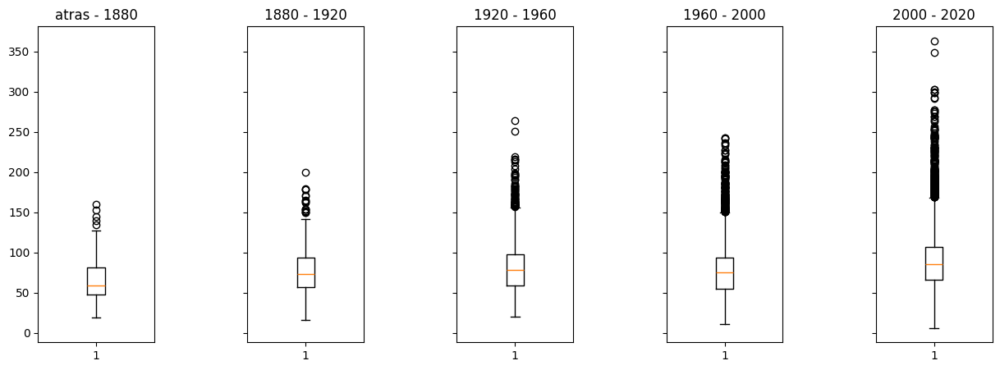

In [35]:
periodos = [df_1880_atras, df_1920_atras, df_1960_atras, df_2000_atras, df_2020_atras]
titulos = ['atras - 1880', '1880 - 1920', '1920 - 1960', '1960 - 2000', '2000 - 2020']
fig, ax = plt.subplots(1, 5, figsize= (15, 5), sharex= 'col', sharey= 'row')
fig.subplots_adjust(hspace= 0.4, wspace= 0.8)
for index, per in enumerate(periodos):
    ax[index].boxplot(per.moves)
    ax[index].set_title(f"{titulos[index]}")

In [36]:
medias_periodos = []
for index, per in enumerate(periodos):
    media = round(per.moves.mean(), 0)
    medias_periodos.append(media)
    print(f'periodo {index + 1}', media)

    # en los boxplots no se nota tanto, pero ahora mirando los numeros si veo una subida curiosa de los moves por partida, aunque tampoco es algo que me vuele la cabeza
    # supongo que a dia de hoy todo esta estudiado y ante un escenario el jugador altual sabe como responder acorde a estudio de escenarios similares o iguales anteriores, y el adversario igual, y asi se alarga la partida hasta
    # llegar a un escenario desconocido donde ya se decide

    # si encuentro un data de evolucion de bases de datos de partidas de ajedrez en el tiempo y la correlaciono con la q de movimientos igual podria probar la hipotesis?
    # ahora no dispongo de esa data, si la encuentro lo miro

    # nota: no lo encontre

periodo 1 66.0
periodo 2 77.0
periodo 3 81.0
periodo 4 77.0
periodo 5 90.0


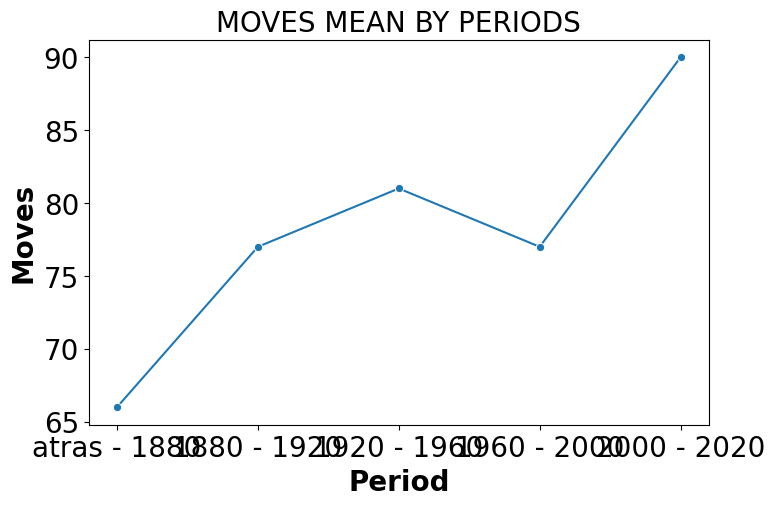

In [37]:
# vamos a verlo graficamente

plt.figure(figsize=(8, 5))
sns.lineplot(x= titulos, y= medias_periodos, marker= 'o')
#plt.xticks(rotation=45)
plt.title('MOVES MEAN BY PERIODS', size= 20)
plt.ylabel('Moves', fontweight='bold', size= 20)
plt.xlabel('Period', fontweight='bold', size= 20)
plt.tick_params(axis='both', labelsize= 20);
#plt.savefig('evolucion_moves_por_periodo.png')

# no parece que haya mucha diferencia por periodos, parece que las partidas se va alargando con el tiempo, pero no significativamente en lo referente a descriptivas, rollo medias, 
# percentiles, medianas y tal
# si que hay partidas mas largas en los outliers, muchas mas y mucho mas largas, y si se van incrementando con el tiempo
# una partida muy larga en el primer periodo podian ser 150 moves, ahora podrian rondar los 300 moves y mas 

<Axes: xlabel='moves', ylabel='Count'>

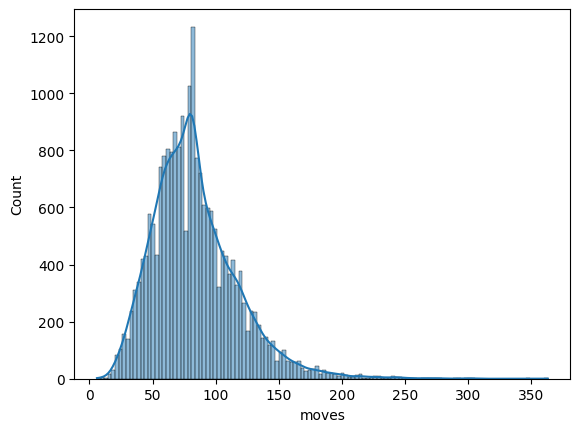

In [66]:
sns.histplot(df_gm, x= 'moves', kde= True)

# los movimientos se distribuyen normalmente, media y mediana similares
#df_gm.moves.describe()

In [39]:
# voy a estudiar a caruana que es un crack y no tengo data suya individual, asi que la cojo de aqui

df_caruana = df_gm[df_gm['player'] == 'Caruana']

# creamos un dataset para capablanca, que me sucede como con caruana

df_capablanca = df_gm[df_gm['player'] == 'Capablanca']

C:\Users\franc\AppData\Local\Temp\ipykernel_24560\3203739051.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(res_caruana, palette= 'bright')


Text(0.5, 1.0, 'Caruana results')

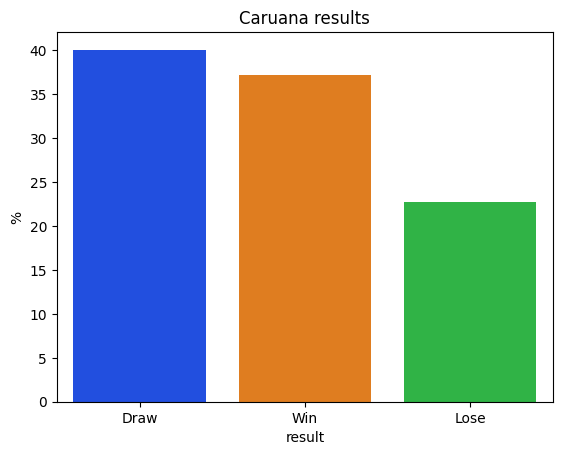

In [40]:
# a ver los resultados de caruana

res_caruana = df_caruana.result.value_counts(normalize= True) * 100
sns.barplot(res_caruana, palette= 'bright')
plt.ylabel('%')
plt.title('Caruana results')
#plt.savefig('./caruana/barras_resultados.png', transparent= True);



<Axes: xlabel='moves'>

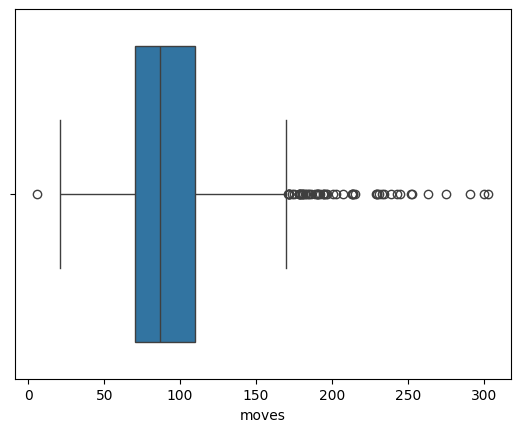

In [41]:
# boxplot del elo de la cantidad de movimientos de caruana
sns.boxplot(df_caruana, x= 'moves')



elo medio oponentes de caruana


2656.285421994885

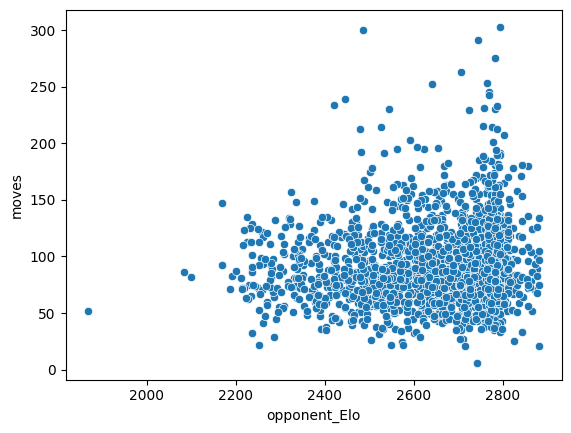

In [42]:
# vamos a ver la correlacion entre el elo del oponente de caruana y la q de movimientos
sns.scatterplot(df_caruana, x= 'opponent_Elo', y= 'moves')
# no veo correlacion

# a ver el elo medio de los oponentes de caruana
print('elo medio oponentes de caruana')
df_caruana.opponent_Elo.mean()


C:\Users\franc\AppData\Local\Temp\ipykernel_24560\2512087824.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(res_capablanca, palette= 'bright')


Text(0.5, 1.0, 'Capablanca results')

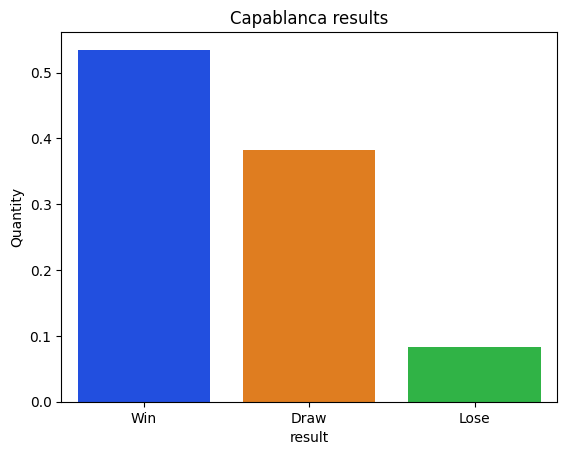

In [43]:
# vamos a hacer lo mismo con capablanca

res_capablanca = df_capablanca.result.value_counts(normalize= True)
sns.barplot(res_capablanca, palette= 'bright')
plt.ylabel('Quantity')
plt.title('Capablanca results')
#plt.savefig('./capablanca/barras_resultados.png', transparent= True);

## analizamos el data de FIDE y sus cerca de 5000 jugadores

In [45]:
df_active_2023 = pd.read_csv('./data/data_fide/fide_active_players_2023_limpio.csv')

# hay que actualizar algunos datos pues los elos se han modificado ligeramente en los ultimos meses y seran relevantes en las graficas siguientes

index = df_active_2023.loc[df_active_2023['Name'] == 'Carlsen, Magnus'].index
df_active_2023.loc[index, 'Standard Rating'] = 2830

index = df_active_2023.loc[df_active_2023['Name'] == 'Caruana, Fabiano'].index
df_active_2023.loc[index, 'Standard Rating'] = 2803

index = df_active_2023.loc[df_active_2023['Name'] == 'Nakamura, Hikaru'].index
df_active_2023.loc[index, 'Standard Rating'] = 2789

index = df_active_2023.loc[df_active_2023['Name'] == 'Abdusattorov, Nodirbek'].index
df_active_2023.loc[index, 'Standard Rating'] = 2765

index = df_active_2023.loc[df_active_2023['Name'] == 'Ding, Liren'].index
df_active_2023.loc[index, 'Standard Rating'] = 2762

index = df_active_2023.loc[df_active_2023['Name'] == 'Firouzja, Alireza'].index
df_active_2023.loc[index, 'Standard Rating'] = 2760

index = df_active_2023.loc[df_active_2023['Name'] == 'Nepomniachtchi, Ian'].index
df_active_2023.loc[index, 'Standard Rating'] = 2758

df_active_2023 = df_active_2023.sort_values(by= 'Standard Rating', ascending= False)
df_active_2023 = df_active_2023.reset_index(drop= True)

In [46]:
# a ver los mejores jugadores

df_active_2023.head(5).sort_values(by= 'Standard Rating', ascending= False)

,Name,Title,Country,Standard Rating,Rapid Rating,Blitz Rating,Birth Year,Age
0,"Carlsen, Magnus",GM,Norway,2830.0,2818.0,2887.0,1990.0,33.0
1,"Caruana, Fabiano",GM,United States,2803.0,2765.0,2813.0,1992.0,31.0
2,"Nakamura, Hikaru",GM,United States,2789.0,2731.0,2874.0,1987.0,36.0
3,"Abdusattorov, Nodirbek",GM,Uzbekistan,2765.0,2727.0,2694.0,2004.0,19.0
4,"Ding, Liren",GM,China,2762.0,2830.0,2787.0,1992.0,31.0


In [47]:
# a ver las medias por federacion segun el estilo de juego

fed_elos = df_active_2023.groupby('Country')['Standard Rating'].mean().sort_values(ascending= False)
fed_rapid = df_active_2023.groupby('Country')['Rapid Rating'].mean().sort_values(ascending= False)
fed_blitz = df_active_2023.groupby('Country')['Blitz Rating'].mean().sort_values(ascending= False)

C:\Users\franc\AppData\Local\Temp\ipykernel_24560\1119330294.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=fed_elos.head(5), palette= 'bright')


Text(0.5, 1.0, 'Highest ELO by Federation')

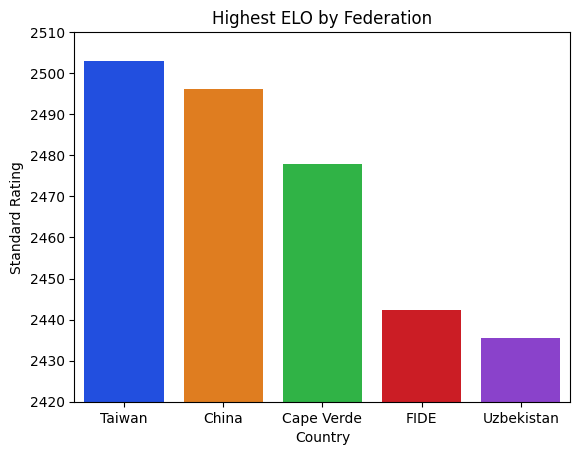

In [48]:
sns.barplot(data=fed_elos.head(5), palette= 'bright')
plt.ylim(2420, 2510)
plt.title('Highest ELO by Federation')
#plt.style.use("grayscale")
#plt.savefig('elo_por_fed.png', transparent= True)

C:\Users\franc\AppData\Local\Temp\ipykernel_24560\1979038947.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=fed_elos_top_10.head(5), palette= 'bright')


Text(0.5, 1.0, 'Highest ELO by Federation Top 10')

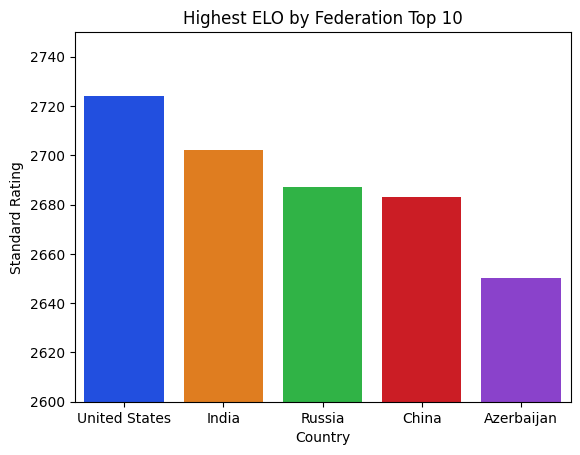

In [49]:
# con este snippet estoy generando un nuevo df en el que recojo los los top 10 jugadores de cada federacion
# genero un objeto groupby por federaciones sobre el que itero y selecciono los top 10 por rating general, los agrego a una lista con la que final mente concateo/genero un nuevo df para trabajar

grupos = df_active_2023.groupby('Country')
top_10_por_grupo = []

for nombre, pais in grupos:

    grupo_ordenado = pais.sort_values(by= 'Standard Rating', ascending= False)
    top_10 = grupo_ordenado.head(10)
    top_10_por_grupo.append(top_10)

df_top_10_por_fed = pd.concat(top_10_por_grupo)
# este nuevo df no esta agrupado 

# agrupo el nuevo df por federaciones y saco la media de cada una, la ordeno para coger los 5 mejores y genero la grafica

fed_elos_top_10 = df_top_10_por_fed.groupby('Country')['Standard Rating'].mean().sort_values(ascending= False)

sns.barplot(data=fed_elos_top_10.head(5), palette= 'bright')
plt.ylim(2600, 2750)
plt.title('Highest ELO by Federation Top 10')
#plt.savefig('elo_por_fed_top_10.png', transparent= True)

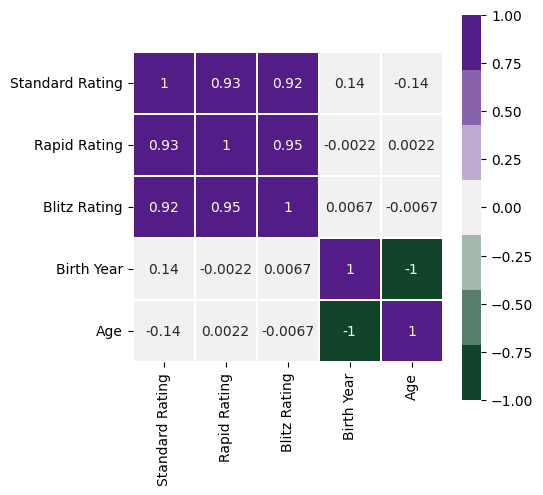

In [50]:
matriz = df_active_2023.corr(numeric_only= True)

plt.figure(figsize=(5,5))
sns.heatmap(matriz,
            vmin=-1,
            vmax=1,
            cmap=sns.diverging_palette(145, 280, s=85, l=25, n=7),
            square=True,
            linewidths=.1,
            annot=True);

# como era previsible vemos una correlacion muy elevada entre los diferentes ratings (clasico, rapid y blitz)
# pense que quizas encontraria alguna correlacion entre la edad y los ratings, pero no

C:\Users\franc\AppData\Local\Temp\ipykernel_24560\1330925239.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(df_active_2023.head(4)['Standard Rating'], palette= 'bright')


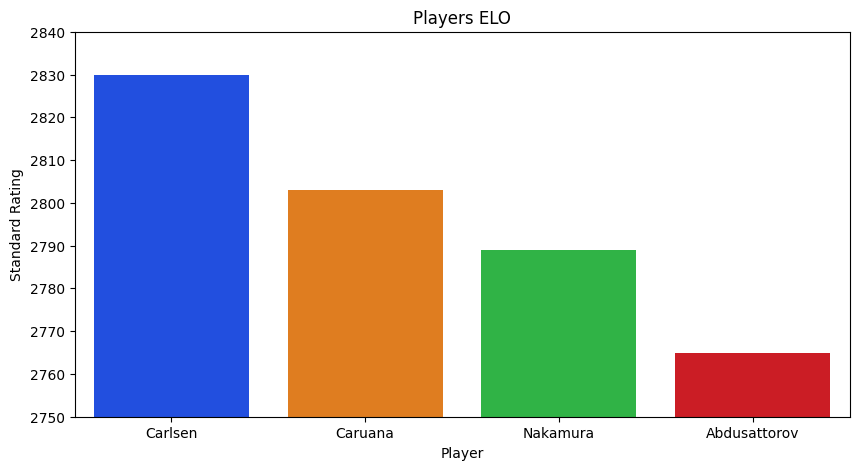

In [51]:
# quiero representar graficamente los mejores jugadores

#names = df_active_2023.head(4).Name
names = ['Carlsen', 'Caruana', 'Nakamura', 'Abdusattorov']
colors = ['blue', 'orange', 'green', 'red']

plt.figure(figsize= (10, 5))
sns.barplot(df_active_2023.head(4)['Standard Rating'], palette= 'bright')
plt.ylim(2750, 2840)
plt.title('Players ELO')
plt.xlabel('Player')
plt.xticks(ticks= range(len(df_active_2023.head(4))), labels= names);
#plt.legend(names);
#plt.savefig('mayores_elo_por_jugador.png', transparent= True)

## analizamos la data de kasparov

In [52]:
df_kasparov = pd.read_csv('./data/kasparov_76_21/df_kasparov_limpio.csv')
df_kasparov['date_played'] = pd.to_datetime(df_kasparov['date_played'])

In [53]:
# quiero una columna que diga si gano, perdio o empato

def resultado(value):
    name = 'Kasparov, Gary'
    name1 = 'Kasparov,G'  # aparece de las dos formas
    if value == name or value == name1:
        return 'Win'
    elif value == 'draw':
        return 'Draw'
    else:
        return 'Lose'
    
df_kasparov['resultado'] = df_kasparov['winner'].transform(resultado)

C:\Users\franc\AppData\Local\Temp\ipykernel_24560\3833961813.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x= df_kasparov['resultado'].value_counts().index, y= df_kasparov['resultado'].value_counts(normalize= True).values * 100, palette= 'tab10', order= ['Draw', 'Lose', 'Win'])


Text(0, 0.5, '%')

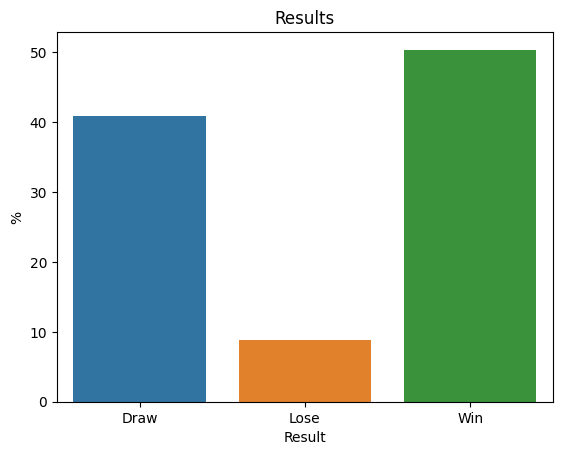

In [54]:
sns.barplot(x= df_kasparov['resultado'].value_counts().index, y= df_kasparov['resultado'].value_counts(normalize= True).values * 100, palette= 'tab10', order= ['Draw', 'Lose', 'Win'])
plt.title('Results') 
plt.xlabel('Result')  
plt.ylabel('%')  
#plt.savefig('resultados_kasparov.png', transparent= True)

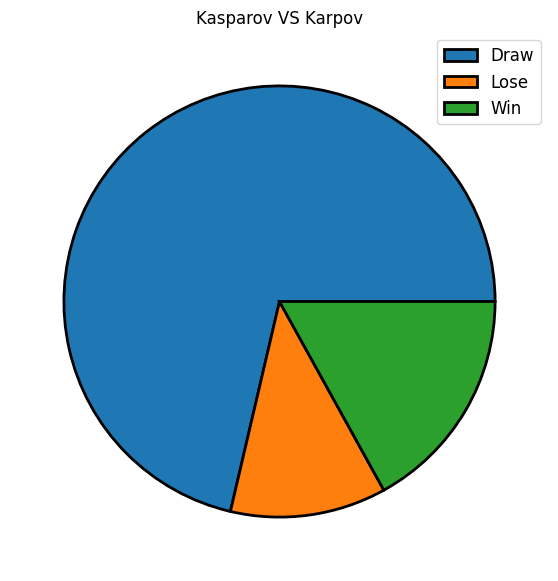

In [55]:
# kasparov tuvo una gran rivalidad con karpov y megustaria visualizarla

df_rival = df_kasparov[(df_kasparov['white'] == 'Karpov, Anatoly') | (df_kasparov['black'] == 'Karpov, Anatoly')]

res_kasparov_karpov = df_rival['resultado'].value_counts()

plt.figure(figsize= (7, 7))
plt.pie(res_kasparov_karpov.sort_index(), wedgeprops={'edgecolor': 'black', 'linewidth': 2})
plt.title('Kasparov VS Karpov')
plt.legend(res_kasparov_karpov.sort_index().index, loc= 'best', fontsize= 'large');
#plt.savefig('kasparov_vs_karpov_pie.png', transparent= True)

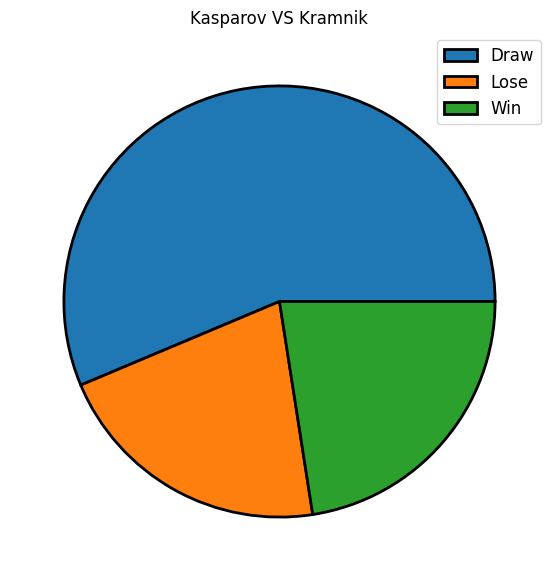

In [56]:
# sucede igual con kramnik, contra quien perdio el titulo

df_rival = df_kasparov[(df_kasparov['white'] == 'Kramnik, Vladimir') | (df_kasparov['black'] == 'Kramnik, Vladimir')]

res_kasparov_kramnik = df_rival['resultado'].value_counts()

plt.figure(figsize= (7, 7))
plt.pie(res_kasparov_kramnik.sort_index(), wedgeprops={'edgecolor': 'black', 'linewidth': 2})
plt.title('Kasparov VS Kramnik')
plt.legend(res_kasparov_kramnik.sort_index().index, loc= 'best', fontsize= 'large');
#plt.savefig('kasparov_vs_kramnick_pie.png', transparent= True)

## vamos a analizar la data de fischer

In [57]:
df_fisher = pd.read_csv('./data/fisher/df_fisher_limpio.csv')
df_fisher['date_played'] = pd.to_datetime(df_fisher['date_played'])

def resultado(value):
    name = 'Fischer, Robert James'
    if value == name:
        return 'Win'
    elif value == 'draw':
        return 'Draw'
    else:
        return 'Lose'

df_fisher['resultado'] = df_fisher['winner'].transform(resultado) # creamos la columna de resultado

C:\Users\franc\AppData\Local\Temp\ipykernel_24560\2945491193.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x= df_fisher['resultado'].value_counts().index, y= df_fisher['resultado'].value_counts(normalize= True).values * 100, palette= 'tab10', order= ['Draw', 'Win', 'Lose'])


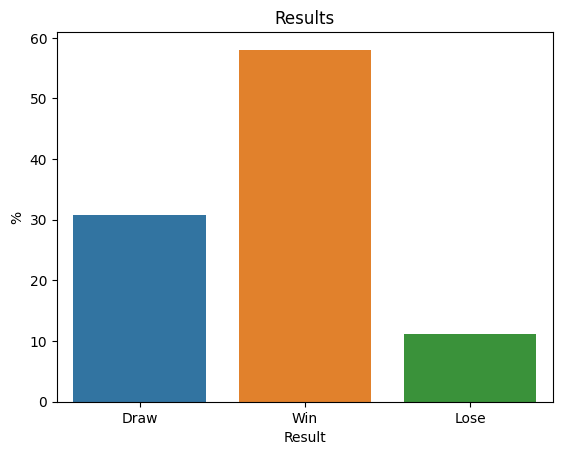

In [58]:
# estadisticas de victorias, derrotas y tablas

sns.barplot(x= df_fisher['resultado'].value_counts().index, y= df_fisher['resultado'].value_counts(normalize= True).values * 100, palette= 'tab10', order= ['Draw', 'Win', 'Lose'])
plt.title('Results') 
plt.xlabel('Result')  
plt.ylabel('%')  ;
#plt.savefig('resultados_fisher.png', transparent= True)

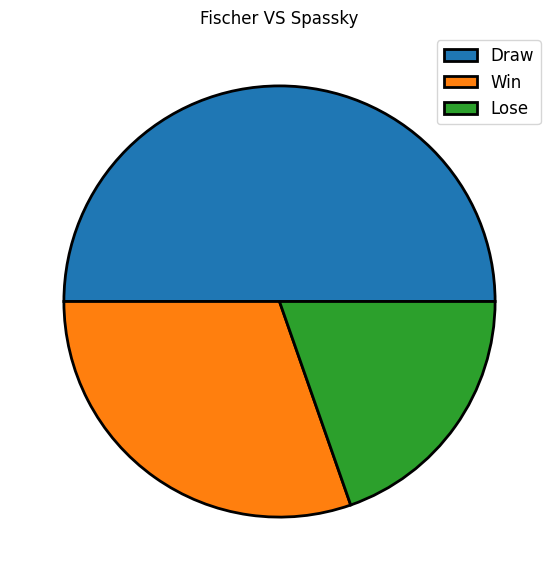

In [59]:
# quiero estudiar la rivalidad contra spassky, este si fue el duelo de ajedrez durante la guerra fria memorable, la partida del siglo la llamaron

df_rival = df_fisher[(df_fisher['white'] == 'Spassky, Boris V') | (df_fisher['black'] == 'Spassky, Boris V')]

res_fischer_spassky = df_rival['resultado'].value_counts()

plt.figure(figsize= (7, 7))
plt.pie(res_fischer_spassky, wedgeprops={'edgecolor': 'black', 'linewidth': 2})
plt.title('Fischer VS Spassky')
plt.legend(['Draw', 'Win', 'Lose'], loc= 'best', fontsize= 'large');
#plt.savefig('fischer_vs_spassky_pie.png', transparent= True)

## vamos a analizar el data de carlsen

In [60]:
df_carlsen = pd.read_csv('./data/carlsen/df_carlsen_limpio.csv')
df_carlsen['date_played'] = pd.to_datetime(df_carlsen['date_played'])

def resultado(value):
    name = 'Carlsen,M'
    if value == name:
        return 'Win'
    elif value == 'draw':
        return 'Draw'
    else:
        return 'Lose'
    
df_carlsen['resultado'] = df_carlsen['winner'].transform(resultado)

C:\Users\franc\AppData\Local\Temp\ipykernel_24560\3119480916.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x= df_carlsen['resultado'].value_counts().index, y= df_carlsen['resultado'].value_counts(normalize= True).values * 100, palette= 'tab10')


Text(0, 0.5, '%')

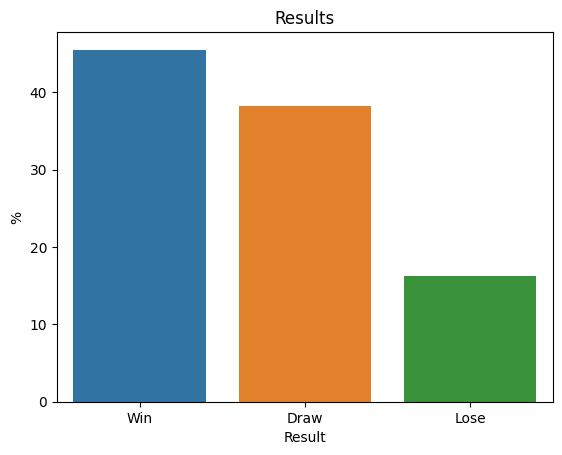

In [61]:
sns.barplot(x= df_carlsen['resultado'].value_counts().index, y= df_carlsen['resultado'].value_counts(normalize= True).values * 100, palette= 'tab10')
plt.title('Results') 
plt.xlabel('Result')  
plt.ylabel('%')  
#plt.savefig('resultados_carlsen.png', transparent= True)

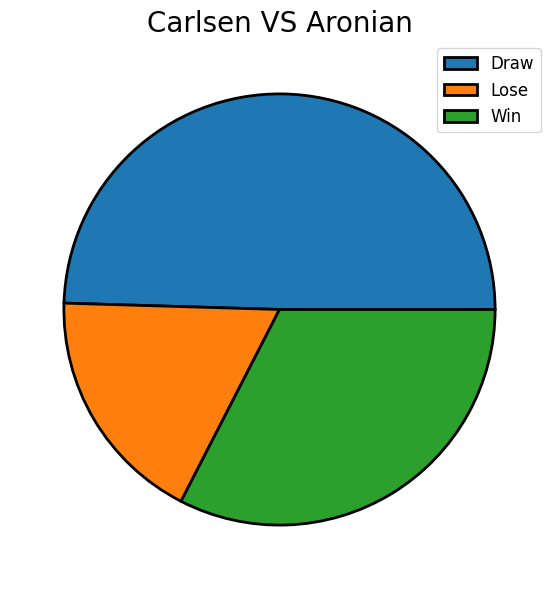

In [62]:
# estudiamos sus rivalidades contra cuatro grandes jugadores, concretamente los que mas se le atascan

df_rival = df_carlsen[(df_carlsen['white'] == 'Aronian,L') | (df_carlsen['black'] == 'Aronian,L')]

res_carlsen_aronian = df_rival['resultado'].value_counts()

plt.figure(figsize= (7, 7))
plt.pie(res_carlsen_aronian.sort_index(), wedgeprops={'edgecolor': 'black', 'linewidth': 2})
plt.title('Carlsen VS Aronian', fontsize= 20)
plt.legend(res_carlsen_aronian.sort_index().index, loc= 'best', fontsize= 'large');
#plt.savefig('carlsen_vs_aronian_pie.png', transparent= True)

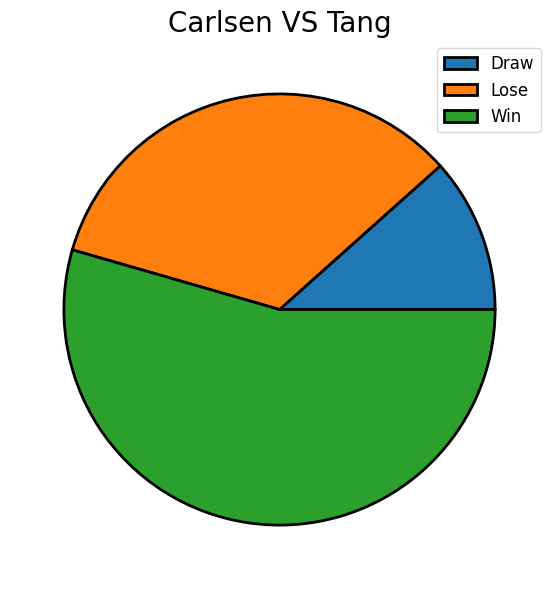

In [63]:
df_rival = df_carlsen[(df_carlsen['white'] == 'Tang,Andrew') | (df_carlsen['black'] == 'Tang,Andrew')]

res_carlsen_tang = df_rival['resultado'].value_counts()

plt.figure(figsize= (7, 7))
plt.pie(res_carlsen_tang.sort_index(), wedgeprops={'edgecolor': 'black', 'linewidth': 2})
plt.title('Carlsen VS Tang', fontsize= 20)
plt.legend(res_carlsen_tang.sort_index().index, loc= 'best', fontsize= 'large');
#plt.savefig('carlsen_vs_tang_pie.png', transparent= True)

# es interesante que contra aronian y nakamura tiene muchos mas empates y luego mas victorias que derrotas
# contra tang es o ganar o perder, los empates son mucho mas reducidos pero el porcentaje de derrotas contra tang es mucho mas elevado que contra los otros, sera por el estilo de juego de tang?

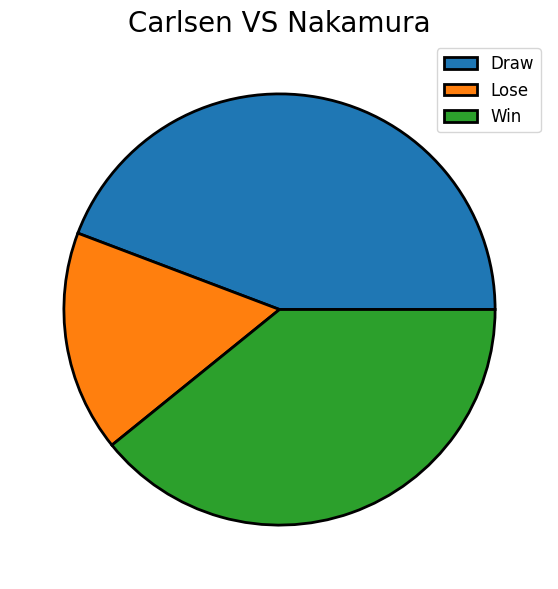

In [64]:
df_rival = df_carlsen[(df_carlsen['white'] == 'Nakamura,Hi') | (df_carlsen['black'] == 'Nakamura,Hi')]

res_carlsen_nakamura = df_rival['resultado'].value_counts()

plt.figure(figsize= (7, 7))
plt.pie(res_carlsen_nakamura.sort_index(), wedgeprops={'edgecolor': 'black', 'linewidth': 2})
plt.title('Carlsen VS Nakamura', fontsize= 20)
plt.legend(res_carlsen_nakamura.sort_index().index, loc= 'best', fontsize= 'large');
#plt.savefig('carlsen_vs_nakamura_pie.png', transparent= True)

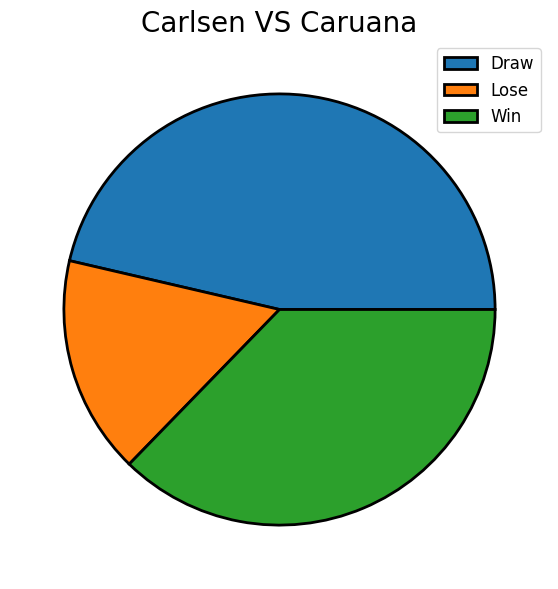

In [65]:
df_rival = df_carlsen[(df_carlsen['white'].str.contains('Caruana')) | (df_carlsen['black'].str.contains('Caruana'))]

res_carlsen_caruana = df_rival['resultado'].value_counts()

plt.figure(figsize= (7, 7))
plt.pie(res_carlsen_caruana.sort_index(), wedgeprops={'edgecolor': 'black', 'linewidth': 2})
plt.title('Carlsen VS Caruana', fontsize= 20)
plt.legend(res_carlsen_caruana.sort_index().index, loc= 'best', fontsize= 'large');
#plt.savefig('carlsen_vs_caruana_pie.png', transparent= True)